# Convolutional Neural Networks with TensorFlow

Andrii Yerko KA-81

In [1]:
# if using Colab - run this cell for saving on the Google Drive
from pathlib import Path
from google.colab import drive

drive.mount('/content/gdrive')

Path("gdrive/MyDrive/lab3_cnn").mkdir(parents=True, exist_ok=True)

%cd /content/gdrive/MyDrive/lab3_cnn

Mounted at /content/gdrive
/content/gdrive/MyDrive/lab3_cnn


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.model_selection import train_test_split

from IPython.display import clear_output

%tensorflow_version 2.x
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
    print('GPU device not found')
print('Found GPU at: {}'.format(device_name))
tf.config.threading.set_intra_op_parallelism_threads(0)

from tensorflow.keras import Sequential, Input, initializers, optimizers, callbacks, layers

from tensorflow.keras.layers import AveragePooling2D, BatchNormalization, Conv2D, Dense, Dropout, Flatten, MaxPool2D
from tensorflow.keras.metrics import AUC

from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import TensorBoard
%load_ext tensorboard

!pip install tensorflow_addons
import tensorflow_addons as tfa
from tensorflow_addons.metrics import F1Score

SEED = 413

# Варіант 3: Датасет Cifar10
from tensorflow.keras.datasets.cifar10 import load_data

Found GPU at: /device:GPU:0
     |████████████████████████████████| 706kB 16.8MB/s 


# Data loading

In [3]:
(X_train, y_train), (X_test, y_test) = load_data()
# original dataset is splitted 5:1, so according to the task we should resplit it

X = np.vstack([X_train, X_test]) / 255
y = np.vstack([y_train, y_test])
n_classes = len(np.unique(y))
y = to_categorical(y)

X_train, X_hold, y_train, y_hold = \
                        train_test_split(X, y, test_size=0.3, random_state=SEED)

X_val, X_test, y_val, y_test = train_test_split(X_hold, y_hold, test_size=0.5, random_state=SEED)

X_train.shape, X_test.shape, X_val.shape, y_train.shape, y_test.shape, y_val.shape

170500096/170498071 [==============================] - 2s 0us/step


((42000, 32, 32, 3),
 (9000, 32, 32, 3),
 (9000, 32, 32, 3),
 (42000, 10),
 (9000, 10),
 (9000, 10))

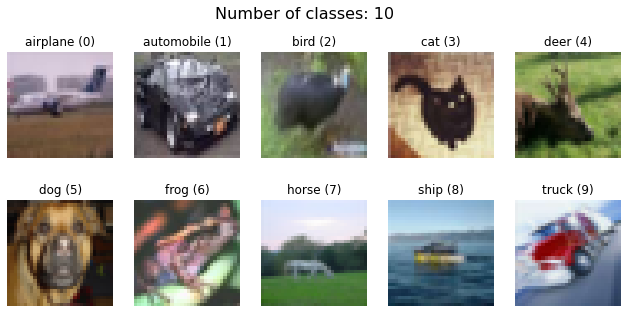

In [4]:
labels = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']

fig, axs = plt.subplots(2, 5, figsize=(11, 5))
fig.suptitle(f"Number of classes: {n_classes}", fontsize=16)

for i, ax in enumerate(axs.flatten()):
    ind = np.random.choice(np.nonzero(y_train[:, i])[0])
    ax.imshow(X_train[ind])
    ax.set_title(f'{labels[i]} ({i})')
    ax.axis('off')

Отже, маємо датасет з 60000 (42000:9000:9000) rgb-зображень розміром 32х32, що рівномірно розподілені по 10 класам

# Models

In [5]:
metrics = [
    'accuracy',
    F1Score(10, average='macro', name='f1'),
    AUC(name='auc')
]

fit_params = {
    'x': X_train,
    'y': y_train,
    'validation_data': (X_val, y_val),
}

compilation_params = {
    'optimizer': optimizers.SGD(lr=0.001, momentum=0.9),
    'loss': 'categorical_crossentropy',
    'metrics': ['accuracy']  # for balanced dataset there is no such difference between acc and f1
                             # and auc is always high. So, for computational efficiency reasons
                             # we going to leave accuracy as the only metric
}

## Baseline

In [6]:
perceptron = tf.keras.models.load_model('../lab2_perceptron/models/final_model')
perceptron.evaluate(X_val, y_val)

282/282 [==============================] - 1s 3ms/step - loss: 11.0533 - accuracy: 0.6054 - f1: 0.6049 - auc: 0.9249


[11.053278923034668,
 0.6054444313049316,
 0.6049193143844604,
 0.9248576164245605]

## AlexNet-like model

#### V1
Спробуємо побудувати модель, подібну за архітектурою до AlexNet

In [7]:
YerkoNet_v1 = Sequential([
    Conv2D(filters=64, kernel_size=(5, 5), strides=(1, 1),
           padding="same", activation='relu', input_shape=(32, 32, 3)),
    MaxPool2D(pool_size=(2, 2), padding='valid'),
    Conv2D(filters=192, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    MaxPool2D(pool_size=(2, 2), padding='valid'),
    Conv2D(filters=256, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    Conv2D(filters=256, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    Conv2D(filters=192, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    MaxPool2D(pool_size=(2, 2), padding='valid'),
    Flatten(),
    Dense(764, activation='relu'),
    Dense(764, activation='relu'),
    Dense(units=10, activation='softmax')
  ],
  name = "YerkoNet_v1"
)

YerkoNet_v1.summary()

Model: "YerkoNet_v1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_59 (Conv2D)           (None, 32, 32, 64)        4864      
_________________________________________________________________
max_pooling2d_36 (MaxPooling (None, 16, 16, 64)        0         
_________________________________________________________________
conv2d_60 (Conv2D)           (None, 16, 16, 192)       110784    
_________________________________________________________________
max_pooling2d_37 (MaxPooling (None, 8, 8, 192)         0         
_________________________________________________________________
conv2d_61 (Conv2D)           (None, 8, 8, 256)         442624    
_________________________________________________________________
conv2d_62 (Conv2D)           (None, 8, 8, 256)         590080    
_________________________________________________________________
conv2d_63 (Conv2D)           (None, 8, 8, 192)         

In [8]:
YerkoNet_v1.compile(**compilation_params)

history = YerkoNet_v1.fit(**fit_params, epochs=30,
                          callbacks=[TensorBoard(log_dir="logs/v1/")]
                          )

clear_output()
pd.Series({k:v[-1] for k, v in history.history.items()})

loss            0.030677
accuracy        0.990143
val_loss        1.759797
val_accuracy    0.716222
dtype: float64

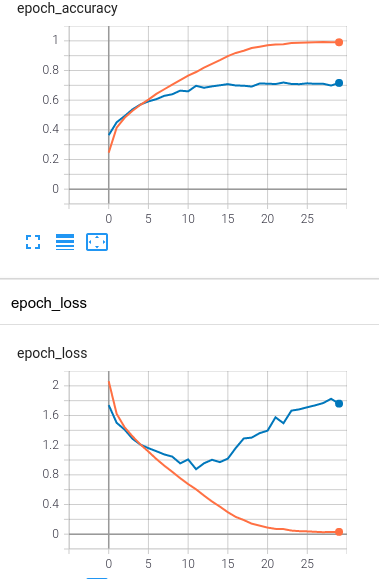

#### V2 (+ Normalization, Dropout)
Спробуємо покращити якість моделі застовувавши зарекомендовані часом практики: Батч-нормалізацію виходу кожного згорткового шару, а також дропаут на виході кожного повнозв'язного шару. В ймовірність відключення оберемо, подібно до оригінальної архітектури, доволі великою - 0.5.

In [9]:
YerkoNet_v2 = Sequential([
    Conv2D(filters=64, kernel_size=(5, 5), strides=(1, 1),
           padding="same", activation='relu', input_shape=(32, 32, 3)),
    BatchNormalization(),
    MaxPool2D(pool_size=(2, 2), padding='valid'),
    Conv2D(filters=192, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    BatchNormalization(),
    MaxPool2D(pool_size=(2, 2), padding='valid'),
    Conv2D(filters=256, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    BatchNormalization(),
    Conv2D(filters=256, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    BatchNormalization(),
    Conv2D(filters=192, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    BatchNormalization(),
    MaxPool2D(pool_size=(2, 2), padding='valid'),
    Flatten(),
    Dense(764, activation='relu'),
    Dropout(0.5),
    Dense(764, activation='relu'),
    Dropout(0.5),
    Dense(units=10, activation='softmax')
  ],
  name = "YerkoNet_v2"
)

YerkoNet_v2.summary()

Model: "YerkoNet_v2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_35 (Conv2D)           (None, 32, 32, 64)        4864      
_________________________________________________________________
batch_normalization_30 (Batc (None, 32, 32, 64)        256       
_________________________________________________________________
max_pooling2d_21 (MaxPooling (None, 16, 16, 64)        0         
_________________________________________________________________
conv2d_36 (Conv2D)           (None, 16, 16, 192)       110784    
_________________________________________________________________
batch_normalization_31 (Batc (None, 16, 16, 192)       768       
_________________________________________________________________
max_pooling2d_22 (MaxPooling (None, 8, 8, 192)         0         
_________________________________________________________________
conv2d_37 (Conv2D)           (None, 8, 8, 256)         

In [10]:
YerkoNet_v2.compile(**compilation_params)

history = YerkoNet_v2.fit(**fit_params, epochs=30,
                          callbacks=[TensorBoard(log_dir="logs/v2_valid/")]
                          )

clear_output()
pd.Series({k:v[-1] for k, v in history.history.items()})

loss            0.061142
accuracy        0.980024
val_loss        1.180786
val_accuracy    0.774889
dtype: float64

Одразу спостерігається суттєве покращення результатів. 

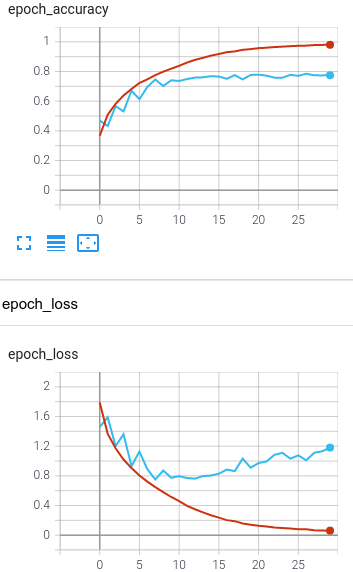

#### V3 (+ wider pooling)
Запозичимо ще одну "фішку" з оригінальної архітектури - спробуємо змінити стратегію пулінгу. Візьмемо вікна більшого розміру (3, 3) замість (2, 2), проте зі страйдом 2 по кожній вісі (тобто один піксель взаємного перекриття)

In [11]:
YerkoNet_v3 = Sequential([
    Conv2D(filters=64, kernel_size=(5, 5), strides=(1, 1),
           padding="same", activation='relu', input_shape=(32, 32, 3)),
    BatchNormalization(),
    MaxPool2D(pool_size=(3, 3), strides=(2, 2), padding='valid'),
    Conv2D(filters=192, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    BatchNormalization(),
    MaxPool2D(pool_size=(3, 3), strides=(2, 2), padding='valid'),
    Conv2D(filters=256, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    BatchNormalization(),
    Conv2D(filters=256, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    BatchNormalization(),
    Conv2D(filters=192, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    BatchNormalization(),
    MaxPool2D(pool_size=(3, 3), strides=(2, 2), padding='valid'),
    Flatten(),
    Dense(764, activation='relu'),
    Dropout(0.5),
    Dense(764, activation='relu'),
    Dropout(0.5),
    Dense(10, activation='softmax')
  ],
  name = "YerkoNet_v3"
)

YerkoNet_v3.summary()

Model: "YerkoNet_v3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_61 (Conv2D)           (None, 32, 32, 64)        4864      
_________________________________________________________________
batch_normalization_56 (Batc (None, 32, 32, 64)        256       
_________________________________________________________________
max_pooling2d_36 (MaxPooling (None, 15, 15, 64)        0         
_________________________________________________________________
conv2d_62 (Conv2D)           (None, 15, 15, 192)       110784    
_________________________________________________________________
batch_normalization_57 (Batc (None, 15, 15, 192)       768       
_________________________________________________________________
max_pooling2d_37 (MaxPooling (None, 7, 7, 192)         0         
_________________________________________________________________
conv2d_63 (Conv2D)           (None, 7, 7, 256)         

In [12]:
YerkoNet_v3.compile(**compilation_params)

history = YerkoNet_v3.fit(**fit_params, epochs=30,
                          callbacks=[TensorBoard(log_dir="logs/v3/")]
                          )

clear_output()
pd.Series({k:v[-1] for k, v in history.history.items()})

loss            0.071756
accuracy        0.976214
val_loss        0.910537
val_accuracy    0.803556
dtype: float64

Хоча кількість параметрів зменшилась внаслідок меншої вихідної розмірності більшого вікна пулінгу, проте результати дещо покращились. Таким чином роби висновок, що "усереднення наявності" грає більшу роль, ніж просторові розмірності вихідної карти

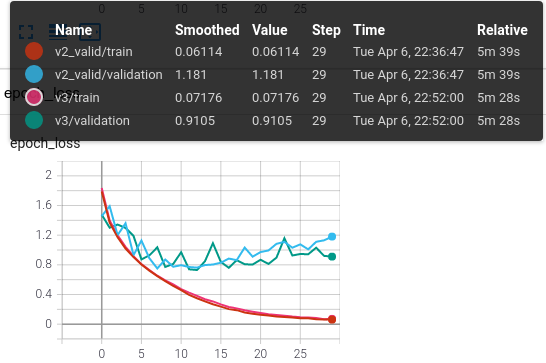

#### V4 (+ AVG pooling)

Спробуємо використати прийом, що можна побачити в архітектурі GoogLeNet, останній шар пулінгу замінимо на пулінг за середнім

In [13]:
YerkoNet_v4 = Sequential(
  [
    Conv2D(filters=64, kernel_size=(5, 5), strides=(1, 1),
           padding="same", activation='relu', input_shape=(32, 32, 3)),
    BatchNormalization(),
    MaxPool2D(pool_size=(3, 3), strides=(2, 2), padding='valid'),
    Conv2D(filters=192, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    BatchNormalization(),
    MaxPool2D(pool_size=(3, 3), strides=(2, 2), padding='valid'),
    Conv2D(filters=256, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    BatchNormalization(),
    Conv2D(filters=256, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    BatchNormalization(),
    Conv2D(filters=192, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    BatchNormalization(),
    AveragePooling2D(pool_size=(3, 3), strides=(2, 2), padding='valid'),
    Flatten(),
    Dense(764, activation='relu'),
    Dropout(0.5),
    Dense(764, activation='relu'),
    Dropout(0.5),
    Dense(10, activation='softmax')
  ],
  name = "YerkoNet_v4"
)

YerkoNet_v4.summary()

Model: "YerkoNet_v4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 32, 32, 64)        4864      
_________________________________________________________________
batch_normalization (BatchNo (None, 32, 32, 64)        256       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 15, 15, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 15, 15, 192)       110784    
_________________________________________________________________
batch_normalization_1 (Batch (None, 15, 15, 192)       768       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 7, 7, 192)         0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 7, 7, 256)         

In [14]:
YerkoNet_v4.compile(**compilation_params)

history = YerkoNet_v4.fit(**fit_params, epochs=30,
                          callbacks=[TensorBoard(log_dir="logs/v4/")]
                          )

clear_output()
pd.Series({k:v[-1] for k, v in history.history.items()})

loss            0.037135
accuracy        0.987571
val_loss        1.085402
val_accuracy    0.803889
dtype: float64

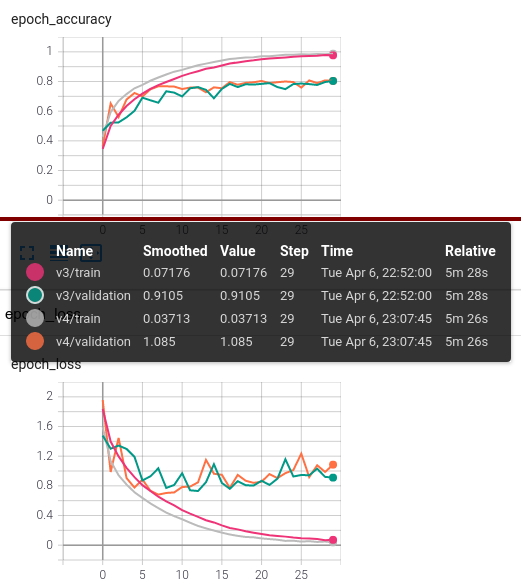

Така модель дещо схильніша до перенавчання, проте за нашої цільовою метрикою дає трішки кращі та стабільніші результати, тому залиши цю зміну.

#### V5 (+ more filters)

In [15]:
YerkoNet_v5 = Sequential(
  [
    Conv2D(filters=96, kernel_size=(5, 5), strides=(1, 1),
           padding="same", activation='relu', input_shape=(32, 32, 3)),
    BatchNormalization(),
    MaxPool2D(pool_size=(3, 3), strides=(2, 2), padding='valid'),
    Conv2D(filters=256, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    BatchNormalization(),
    MaxPool2D(pool_size=(3, 3), strides=(2, 2), padding='valid'),
    Conv2D(filters=384, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    BatchNormalization(),
    Conv2D(filters=384, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    BatchNormalization(),
    Conv2D(filters=256, kernel_size=(3, 3), strides=(1, 1),
           padding="same", activation='relu'),
    BatchNormalization(),
    AveragePooling2D(pool_size=(3, 3), strides=(2, 2), padding='valid'),
    Flatten(),
    Dense(764, activation='relu'),
    Dropout(0.5),
    Dense(764, activation='relu'),
    Dropout(0.5),
    Dense(10, activation='softmax')
  ],
  name = "YerkoNet_v5"
)

YerkoNet_v5.summary()

Model: "YerkoNet_v5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 32, 32, 96)        7296      
_________________________________________________________________
batch_normalization (BatchNo (None, 32, 32, 96)        384       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 15, 15, 96)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 15, 15, 256)       221440    
_________________________________________________________________
batch_normalization_1 (Batch (None, 15, 15, 256)       1024      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 7, 7, 256)         0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 7, 7, 384)         

In [16]:
YerkoNet_v5.compile(
    optimizer='Adam',
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

history = YerkoNet_v5.fit(**fit_params, epochs=30,
                          callbacks=[TensorBoard(log_dir="logs/v5/")]
                          )

clear_output()
pd.Series({k:v[-1] for k, v in history.history.items()})

loss            0.083756
accuracy        0.975857
val_loss        1.065092
val_accuracy    0.798000
dtype: float64

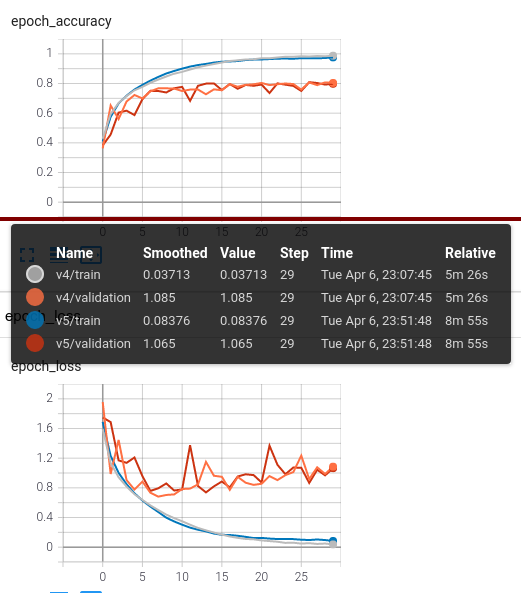

Збільшення кількості фільтрів спричинило більш сильне перенавчання, як наслідок того що ми отримуємо модель більшої ємності при не такому великому обсязі навчальної вибірки. Більш складна модель потребує інших підходів до навчання (додаткова регуляризація) та обробки данних (аугментація для збільшення вибірки), а тому в рамках цього завдання розглядати її не будемо, замість цього спробуємо покращити результати взявши іншу архітектуру мережі.

## VGG-like model
Далі експериментуватимемо з архітектурою в стилі мережі VGG16. Її ключовою особливістю є группування згорткових шарів з невеликим розміром ядра (3х3) один за одним, після кожного такого блоку здійснюється пулінг за максимумом.

#### V1

In [17]:
model = Sequential(
  [
    Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=(32, 32, 3)),
    BatchNormalization(),
    Conv2D(32, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.4),
    Dense(10, activation='softmax')
  ]
)

model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_12 (Conv2D)           (None, 32, 32, 32)        896       
_________________________________________________________________
batch_normalization (BatchNo (None, 32, 32, 32)        128       
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 32, 32, 32)        9248      
_________________________________________________________________
batch_normalization_1 (Batch (None, 32, 32, 32)        128       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 16, 16, 32)        0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 16, 16, 64)        18496     
_________________________________________________________________
batch_normalization_2 (Batch (None, 16, 16, 64)       

In [18]:
model.compile(**compilation_params)

history = model.fit(**fit_params, epochs=30,
                          callbacks=[TensorBoard(log_dir="logs/vgglike_v1/")]
                          )

clear_output()
pd.Series({k:v[-1] for k, v in history.history.items()})

loss            0.089476
accuracy        0.969333
val_loss        0.986288
val_accuracy    0.793889
dtype: float64

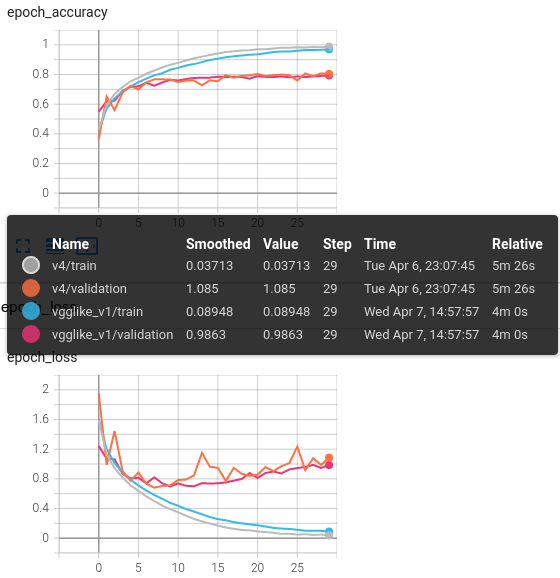

Помітимо, що така модель показує такі ж результати з більшою стабільністю, при тому, що має майже в 11 раз менше параметрів. Таким чином ще раз робимо висновок, що розширення області опосередкованої передачі ознак відіграє більшу роль, ніж інші параметри.

#### V2 (+ more filters)
Спробуємо збільшити кількість фільтрів у всіх шарах

In [19]:
model = Sequential(
  [
    Conv2D(64, (3, 3), activation='relu', padding='same', input_shape=(32, 32, 3)),
    BatchNormalization(),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Conv2D(256, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(256, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.4),
    Dense(10, activation='softmax')
  ]
)

model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_18 (Conv2D)           (None, 32, 32, 64)        1792      
_________________________________________________________________
batch_normalization_6 (Batch (None, 32, 32, 64)        256       
_________________________________________________________________
conv2d_19 (Conv2D)           (None, 32, 32, 64)        36928     
_________________________________________________________________
batch_normalization_7 (Batch (None, 32, 32, 64)        256       
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 16, 16, 64)        0         
_________________________________________________________________
conv2d_20 (Conv2D)           (None, 16, 16, 128)       73856     
_________________________________________________________________
batch_normalization_8 (Batch (None, 16, 16, 128)      

In [20]:
model.compile(**compilation_params)

history = model.fit(**fit_params, epochs=30,
                    callbacks=[TensorBoard(log_dir="logs/vgglike_v2/")]
                    )

clear_output()
pd.Series({k:v[-1] for k, v in history.history.items()})

loss            0.030983
accuracy        0.989595
val_loss        1.017606
val_accuracy    0.803778
dtype: float64

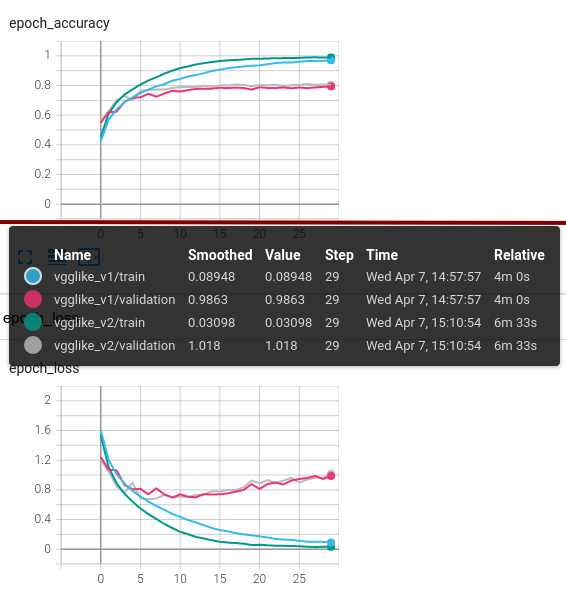

Збільшення кількості фільтрів дає мінімальне покращення якості на валідації, при суттєво швидшій мінімізації на навчальній вибірці, що свідчить про те, що ця модель через збільшення ємності набагато більше схильна до перенавчання на цьому датасеті (теж саме справедливо і для моделей попередньо розглянутої архітектури). З цих міркувань, надалі розглядатимемо "маленьку" модель

#### V3 (AVG pooling)

Спробуємо замінити стратегію останнього шару пулінгу на середнє арифметичне

In [21]:
model = Sequential(
  [
    Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=(32, 32, 3)),
    BatchNormalization(),
    Conv2D(32, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    AveragePooling2D((2, 2)),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.4),
    Dense(10, activation='softmax')
  ]
)

model.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_36 (Conv2D)           (None, 32, 32, 32)        896       
_________________________________________________________________
batch_normalization_24 (Batc (None, 32, 32, 32)        128       
_________________________________________________________________
conv2d_37 (Conv2D)           (None, 32, 32, 32)        9248      
_________________________________________________________________
batch_normalization_25 (Batc (None, 32, 32, 32)        128       
_________________________________________________________________
max_pooling2d_14 (MaxPooling (None, 16, 16, 32)        0         
_________________________________________________________________
conv2d_38 (Conv2D)           (None, 16, 16, 64)        18496     
_________________________________________________________________
batch_normalization_26 (Batc (None, 16, 16, 64)       

In [22]:
model.compile(**compilation_params)

history = model.fit(**fit_params, epochs=30,
                    callbacks=[TensorBoard(log_dir="logs/vgglike_v3/")]
                    )

clear_output()
pd.Series({k:v[-1] for k, v in history.history.items()})

loss            0.047143
accuracy        0.984524
val_loss        0.972299
val_accuracy    0.796556
dtype: float64

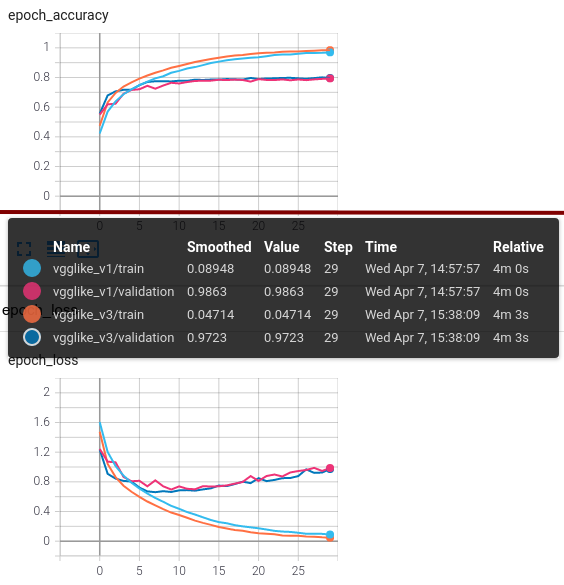

Суттєвої різниці не спостерігається. По аналогії з минулою архітектурою, візьмемо більші вікна пулінгу (3, 3), що перекриваються на 1 піксель

In [23]:
model = Sequential(
  [
    Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=(32, 32, 3)),
    BatchNormalization(),
    Conv2D(32, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    AveragePooling2D((3, 3), strides=(2, 2)),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.4),
    Dense(10, activation='softmax')
  ]
)

model.summary()

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_48 (Conv2D)           (None, 32, 32, 32)        896       
_________________________________________________________________
batch_normalization_36 (Batc (None, 32, 32, 32)        128       
_________________________________________________________________
conv2d_49 (Conv2D)           (None, 32, 32, 32)        9248      
_________________________________________________________________
batch_normalization_37 (Batc (None, 32, 32, 32)        128       
_________________________________________________________________
max_pooling2d_18 (MaxPooling (None, 16, 16, 32)        0         
_________________________________________________________________
conv2d_50 (Conv2D)           (None, 16, 16, 64)        18496     
_________________________________________________________________
batch_normalization_38 (Batc (None, 16, 16, 64)       

In [24]:
model.compile(**compilation_params)

history = model.fit(**fit_params, epochs=30,
                    callbacks=[TensorBoard(log_dir="logs/vgglike_v3.2/")]
                    )

clear_output()
pd.Series({k:v[-1] for k, v in history.history.items()})

loss            0.049023
accuracy        0.984333
val_loss        0.892310
val_accuracy    0.806222
dtype: float64

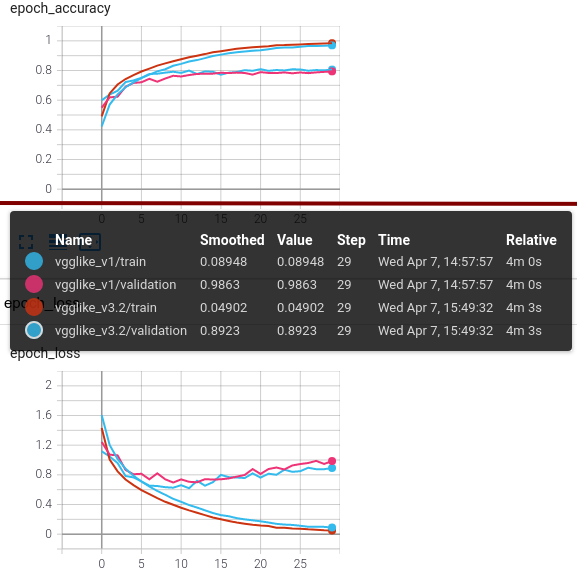

Спостерігається незначне покращення результатів за точністю при зменшенні втрат як на валідаційній так і на навчальній вибірках

#### Summary
Загальний висновок щодо експериментів з цією архітектурою можна зробити такий: одні й ті ж практики покращують результат незалежно від архітектури згорткових шарів, такими практиками є нормалізація виходів згорток та пулінг за середнім перед зв'язними шарами

## Overfitting prevention
Можна помітити, що усі минулі моделі мають спільну проблему - занадто стрімка оптимізація на навчальній вибірці, в результаті чого на ній досягається дуже висока точність, а оптимізація помилики узагальнення "заходить в тупік"

#### Capacity reducing
Спробуємо вирішити цю проблему шляхом вибору ще меншої кількості фільтрів

In [25]:
model = Sequential(
  [
    Conv2D(16, (3, 3), activation='relu', padding='same', input_shape=(32, 32, 3)),
    BatchNormalization(),
    Conv2D(16, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Conv2D(32, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(32, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    AveragePooling2D((2, 2)),
    Flatten(),
    Dense(64, activation='relu'),
    Dropout(0.4),
    Dense(10, activation='softmax')
  ],
  name='VGGLike_micro'
)

model.summary()

Model: "VGGLike_micro"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_54 (Conv2D)           (None, 32, 32, 16)        448       
_________________________________________________________________
batch_normalization_42 (Batc (None, 32, 32, 16)        64        
_________________________________________________________________
conv2d_55 (Conv2D)           (None, 32, 32, 16)        2320      
_________________________________________________________________
batch_normalization_43 (Batc (None, 32, 32, 16)        64        
_________________________________________________________________
max_pooling2d_20 (MaxPooling (None, 16, 16, 16)        0         
_________________________________________________________________
conv2d_56 (Conv2D)           (None, 16, 16, 32)        4640      
_________________________________________________________________
batch_normalization_44 (Batc (None, 16, 16, 32)      

In [26]:
model.compile(**compilation_params)

history = model.fit(**fit_params, epochs=30,
                    callbacks=[TensorBoard(log_dir="logs/vgglike_micro/")]
                    )

clear_output()
pd.Series({k:v[-1] for k, v in history.history.items()})

loss            0.285614
accuracy        0.897333
val_loss        0.850456
val_accuracy    0.750556
dtype: float64

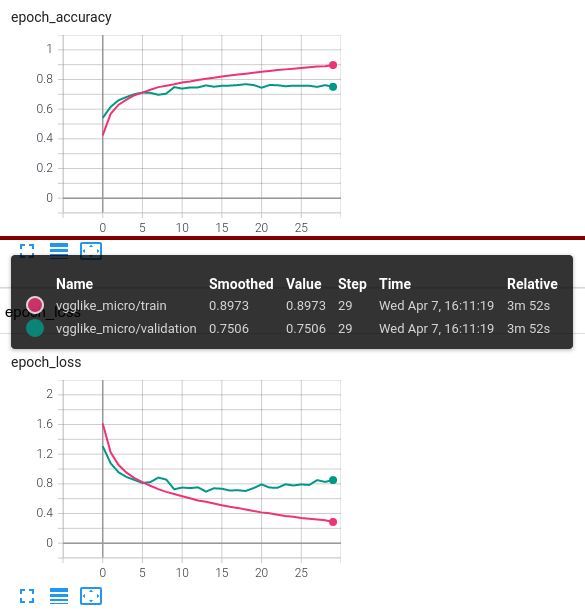

Зменшена модель не в змозі досягти порівняних результатів

### Data augmentation
Спробуємо покращити результати, штучно збільшивши навчальну вибірку за допомогою аугментації зображень, а саме випадкового відзеркалення по вертикалі, зуму, повороту та зміни контрастності. Ці зміни застовуватимуться до входу усіх наступних моделей в режимі навчання.

In [27]:
data_augmentation = Sequential([
  layers.experimental.preprocessing.RandomFlip("horizontal", seed=SEED),
  layers.experimental.preprocessing.RandomZoom(0.1, seed=SEED),
  layers.experimental.preprocessing.RandomRotation(0.15, seed=SEED),
  layers.experimental.preprocessing.RandomContrast(0.2, seed=SEED)
  ],
  name='RandomAugmentator'
)

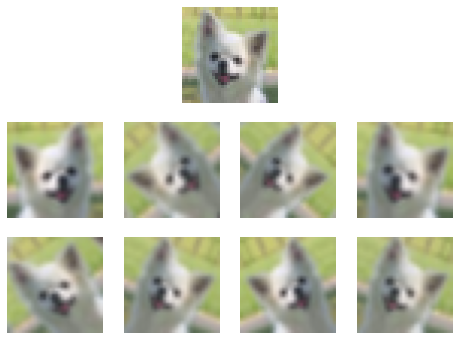

In [28]:
idx = 128 #np.random.randint(len(y_train), size=1)

plt.subplots(figsize=(8, 6))
plt.subplot(3, 3, 2)
plt.imshow(X_train[idx])
plt.axis('off')

for i in range(5, 13):
    plt.subplot(3, 4, i)
    plt.imshow(data_augmentation(X_train[None, idx])[0])
    plt.axis('off')

Також, запозичимо ще одну розповсюджену практику для подібної архітектури та спробуємо додати дропаут після кожного шару пулінгу.
#### V1

In [29]:
AugNet = Sequential(
  [
    Input((32, 32, 3)),
    data_augmentation,
    Conv2D(32, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(32, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Dropout(0.2),

    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Dropout(0.3),

    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    AveragePooling2D((3, 3), strides=(2, 2)),
    Dropout(0.4),

    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.4),
    Dense(10, activation='softmax')
  ],
  name="AugNet"
)

AugNet.summary()

Model: "AugNet"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
RandomAugmentator (Sequentia (None, 32, 32, 3)         0         
_________________________________________________________________
conv2d_24 (Conv2D)           (None, 32, 32, 32)        896       
_________________________________________________________________
batch_normalization_24 (Batc (None, 32, 32, 32)        128       
_________________________________________________________________
conv2d_25 (Conv2D)           (None, 32, 32, 32)        9248      
_________________________________________________________________
batch_normalization_25 (Batc (None, 32, 32, 32)        128       
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 16, 16, 32)        0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 16, 16, 32)        0    

In [30]:
AugNet.compile(
    optimizer=optimizers.Adam(0.0001),
    loss='categorical_crossentropy',
    metrics=['accuracy']
    )

checkpoint_filepath = 'tmp/checkpoint'
model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True
    )

early_stopping = callbacks.EarlyStopping(monitor='val_loss', min_delta=0,
                                         patience=20, verbose=1, mode='auto')


history = AugNet.fit(**fit_params, epochs=400,
                    callbacks=[
                        TensorBoard(log_dir="logs/AugNet_v2/"),
                        model_checkpoint_callback,
                        early_stopping
                      ]
                    )

AugNet.save('models/AugNet')

clear_output()
epochs = len(history.history['loss'])
print(f'After {epochs} epochs')
pd.Series({k:v[-1] for k, v in history.history.items()})

After 327 epochs


loss            0.440255
accuracy        0.849452
val_loss        0.460802
val_accuracy    0.850667
dtype: float64

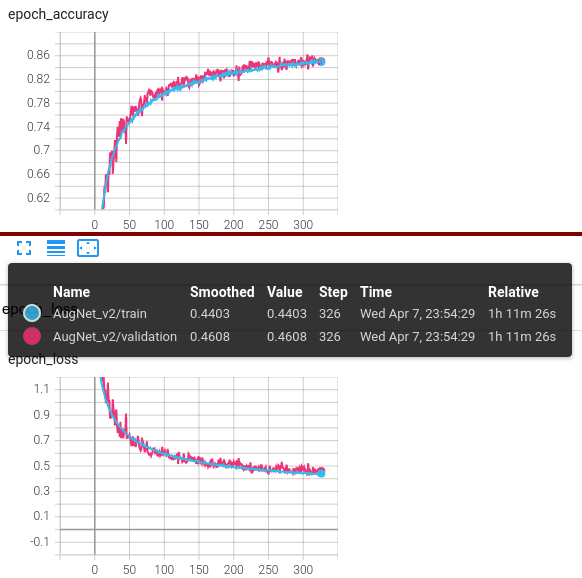

Accuracy виросла майже на 10 відсотків, а різниця між показниками на валідації та на навчальній вибірці мінімальна

#### V2 (bigger model)

In [31]:
AugNet_bigger = Sequential(
  [
    Input((32, 32, 3)),
    data_augmentation,
   
    Conv2D(48, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(48, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Dropout(0.2),

    Conv2D(96, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(96, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Dropout(0.3),

    Conv2D(192, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(192, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    AveragePooling2D((3, 3), strides=(2, 2)),
    Dropout(0.4),

    Flatten(),
    Dense(192, activation='relu'),
    Dropout(0.4),
    Dense(10, activation='softmax')
  ],
  name="AugNet_bigger"
)

AugNet_bigger.summary()

Model: "AugNet_bigger"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
RandomAugmentator (Sequentia (None, 32, 32, 3)         0         
_________________________________________________________________
conv2d_30 (Conv2D)           (None, 32, 32, 48)        1344      
_________________________________________________________________
batch_normalization_30 (Batc (None, 32, 32, 48)        192       
_________________________________________________________________
conv2d_31 (Conv2D)           (None, 32, 32, 48)        20784     
_________________________________________________________________
batch_normalization_31 (Batc (None, 32, 32, 48)        192       
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 16, 16, 48)        0         
_________________________________________________________________
dropout_8 (Dropout)          (None, 16, 16, 48)      

In [32]:
AugNet_bigger.compile(
    optimizer=optimizers.Adam(0.0001),
    loss='categorical_crossentropy',
    metrics=['accuracy']
    )

checkpoint_filepath = 'tmp/checkpoint'
model_checkpoint_callback_b = callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True
    )

early_stopping_b = callbacks.EarlyStopping(monitor='val_loss', min_delta=0,
                                         patience=20, verbose=1, mode='auto')


history = AugNet_bigger.fit(**fit_params, epochs=400, initial_epoch=0,
                    callbacks=[
                        TensorBoard(log_dir="logs/AugNet_bigger/"),
                        model_checkpoint_callback_b,
                        early_stopping_b
                      ]
                    )

AugNet_bigger.save('models/AugNet_bigger')

clear_output()
epochs = len(history.history['loss'])
print(f'After {epochs} epochs')
pd.Series({k:v[-1] for k, v in history.history.items()})

After 240 epochs


loss            0.307812
accuracy        0.894452
val_loss        0.404427
val_accuracy    0.877778
dtype: float64

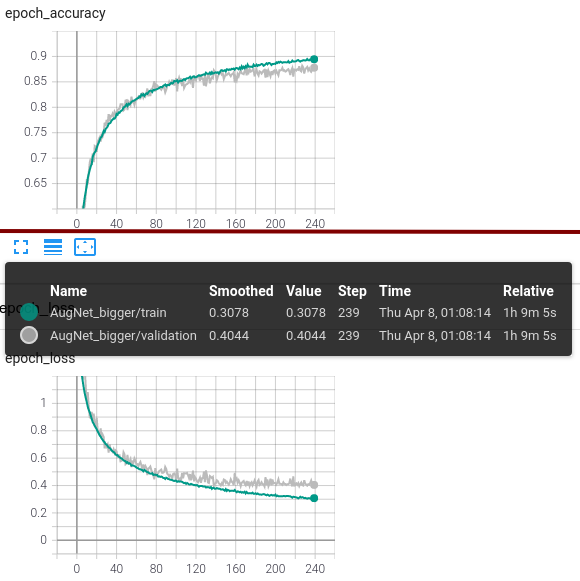

Збільшення кількості фільтрів призвело до покращення результатів на два відсотка

#### V2' (Max pooling on last layer)
Повернемось до дослідження різних варіантів пулінгу та перевіримо їх вплив на цю модель

In [33]:
AugNet_max = Sequential(
  [
    Input((32, 32, 3)),
    data_augmentation,
   
    Conv2D(48, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(48, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Dropout(0.2),

    Conv2D(96, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(96, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Dropout(0.3),

    Conv2D(192, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(192, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Dropout(0.4),

    Flatten(),
    Dense(192, activation='relu'),
    Dropout(0.4),
    Dense(10, activation='softmax')
  ],
  name="AugNet_max"
)

AugNet_max.compile(
    optimizer=optimizers.Adam(0.0001),
    loss='categorical_crossentropy',
    metrics=['accuracy']
    )

history = AugNet_max.fit(**fit_params, epochs=230, initial_epoch=0,
                    callbacks=[
                        TensorBoard(log_dir="logs/AugNet_max/"),
                      ]
                    )

AugNet_max.save('models/AugNet_max')

clear_output()
epochs = len(history.history['loss'])
print(f'After {epochs} epochs')
pd.Series({k:v[-1] for k, v in history.history.items()})

After 230 epochs


loss            0.354121
accuracy        0.877833
val_loss        0.394335
val_accuracy    0.878556
dtype: float64

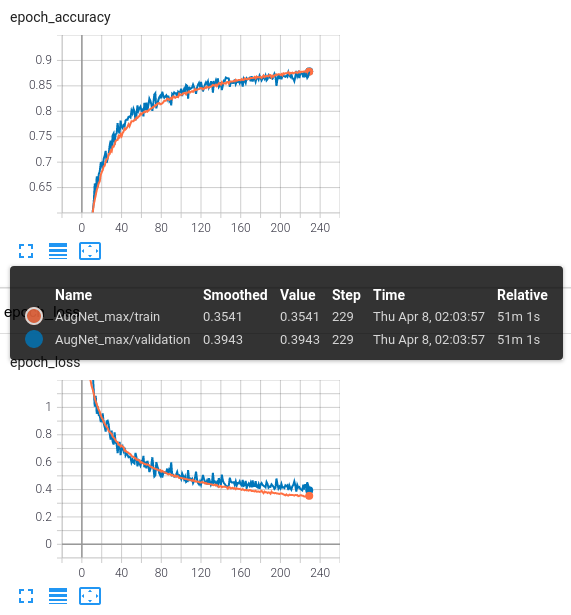

#### V2" (Pooling by average)

In [34]:
AugNet_avg = Sequential(
  [
    Input((32, 32, 3)),
    data_augmentation,
   
    Conv2D(48, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(48, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    AveragePooling2D((2, 2)),
    Dropout(0.2),

    Conv2D(96, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(96, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    AveragePooling2D((2, 2)),
    Dropout(0.3),

    Conv2D(192, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(192, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    AveragePooling2D((3, 3), strides=(2, 2)),
    Dropout(0.4),

    Flatten(),
    Dense(192, activation='relu'),
    Dropout(0.4),
    Dense(10, activation='softmax')
  ],
  name="AugNet_avg"
)

AugNet_avg.compile(
    optimizer=optimizers.Adam(0.0001),
    loss='categorical_crossentropy',
    metrics=['accuracy']
    )

history = AugNet_avg.fit(**fit_params, epochs=230, initial_epoch=0,
                    callbacks=[
                        TensorBoard(log_dir="logs/AugNet_avg/"),
                      ]
                    )

AugNet_avg.save('models/AugNet_avg')

clear_output()
epochs = len(history.history['loss'])
print(f'After {epochs} epochs')
pd.Series({k:v[-1] for k, v in history.history.items()})

After 230 epochs


loss            0.306746
accuracy        0.893833
val_loss        0.390552
val_accuracy    0.882667
dtype: float64

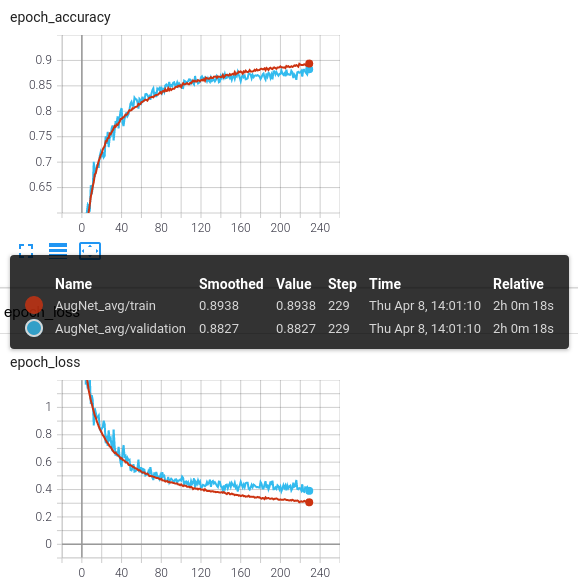

#### Summary

Суттєвої різниці між стратегіями пулінгу не спостерігається при данній конфігурації, окрім того, що модель V2 все ще продовжує покращувати результати на навчальній вибірці. 

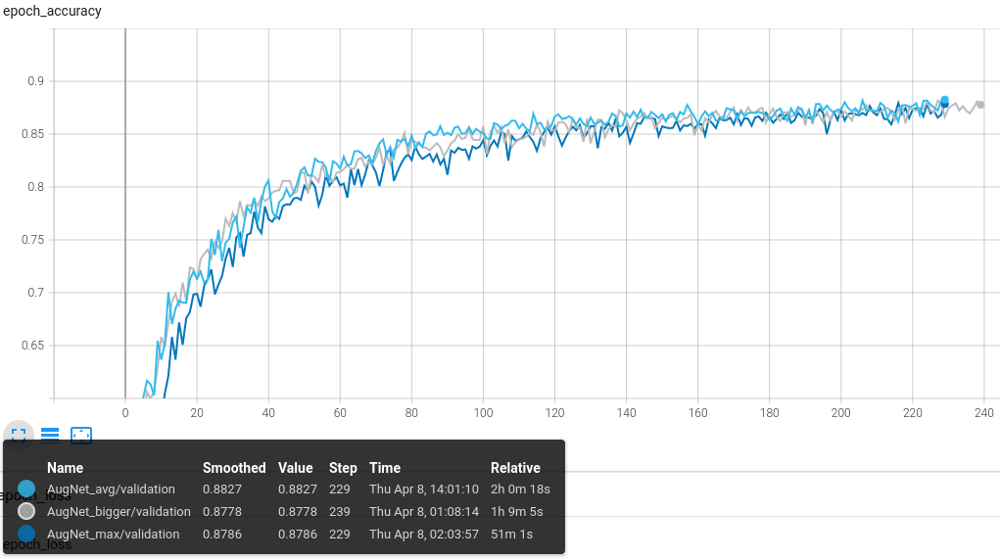

## More experiments

#### Regularization

In [35]:
# AugNet_v3 = Sequential(
#   [
#     Input((32, 32, 3)),
#     data_augmentation,
   
#     Conv2D(48, (3, 3), activation='relu', padding='same', kernel_regularizer='l2'),
#     BatchNormalization(),
#     Conv2D(48, (3, 3), activation='relu', padding='same', kernel_regularizer='l2'),
#     BatchNormalization(),
#     MaxPool2D((2, 2)),
#     Dropout(0.2),

#     Conv2D(96, (3, 3), activation='relu', padding='same', kernel_regularizer='l2'),
#     BatchNormalization(),
#     Conv2D(96, (3, 3), activation='relu', padding='same', kernel_regularizer='l2'),
#     BatchNormalization(),
#     MaxPool2D((2, 2)),
#     Dropout(0.3),

#     Conv2D(192, (3, 3), activation='relu', padding='same', kernel_regularizer='l2'),
#     BatchNormalization(),
#     Conv2D(192, (3, 3), activation='relu', padding='same', kernel_regularizer='l2'),
#     BatchNormalization(),
#     AveragePooling2D((3, 3), strides=(2, 2)),
#     Dropout(0.4),

#     Flatten(),
#     Dense(192, activation='relu', kernel_regularizer='l2'),
#     Dropout(0.4),
#     Dense(10, activation='softmax')
#   ],
#   name="AugNet_v3"
# )

# AugNet_v3.compile(
#     optimizer=optimizers.Adam(0.0001),
#     loss='categorical_crossentropy',
#     metrics=['accuracy']
#     )

# history = AugNet_v3.fit(**fit_params, epochs=230, initial_epoch=0,
#                     callbacks=[
#                         TensorBoard(log_dir="logs/AugNet_v3/"),
#                       ]
#                     )

# AugNet_v3.save('models/AugNet_v3')

# clear_output()
# epochs = len(history.history['loss'])
# print(f'After {epochs} epochs')
# pd.Series({k:v[-1] for k, v in history.history.items()})

Спроба накласти регуляризацію за нормою на ваги не увінчалась успіхом, дропаут дає достатнью регуляризацію для цієї архітектури. Після тривалої відсутності прогресу навчання було перервано.

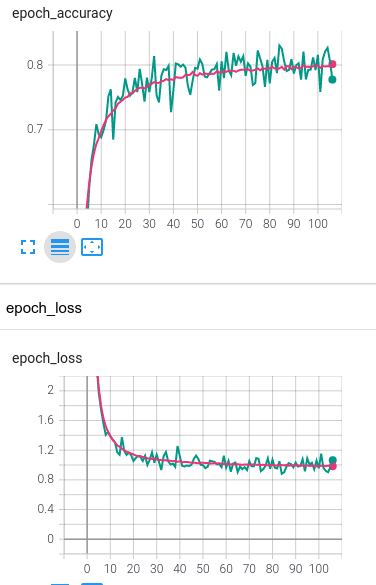

### Deeper model

In [36]:
DeepAugNet = Sequential(
  [
    Input((32, 32, 3)),
    data_augmentation,
   
    Conv2D(32, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(32, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Dropout(0.2),

    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Dropout(0.3),

    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPool2D((2, 2)),
    Dropout(0.4),

    Conv2D(256, (3, 3), activation='relu', padding='same'),
    Conv2D(256, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    AveragePooling2D((3, 3), strides=(1, 1)),
    Dropout(0.4),

    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.4),
    Dense(10, activation='softmax')
  ],
  name="DeepAugNet"
)

DeepAugNet.compile(
    optimizer=optimizers.Adam(0.0005),
    loss='categorical_crossentropy',
    metrics=['accuracy']
    )

history = DeepAugNet.fit(**fit_params, epochs=150, initial_epoch=50,
                    callbacks=[
                        TensorBoard(log_dir="logs/DeepAugNet/"),
                      ]
                    )

DeepAugNet.save('models/DeepAugNet')

clear_output()
epochs = len(history.history['loss'])
print(f'After {epochs} epochs')
pd.Series({k:v[-1] for k, v in history.history.items()})

After 200 epochs


loss            0.341630
accuracy        0.881881
val_loss        0.459458
val_accuracy    0.865000
dtype: float64

Додавання ще одного блоку згорткових шарів призвело лише до погіршення результатів, AugNet_bigger залишається найкращою моделлю з розглянутих

# Testing

In [37]:
AugNetV2 = tf.keras.models.load_model('models/AugNet_bigger')
AugNetV2.summary()

Model: "AugNet_bigger"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
RandomAugmentator (Sequentia (None, 32, 32, 3)         0         
_________________________________________________________________
conv2d_30 (Conv2D)           (None, 32, 32, 48)        1344      
_________________________________________________________________
batch_normalization_30 (Batc (None, 32, 32, 48)        192       
_________________________________________________________________
conv2d_31 (Conv2D)           (None, 32, 32, 48)        20784     
_________________________________________________________________
batch_normalization_31 (Batc (None, 32, 32, 48)        192       
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 16, 16, 48)        0         
_________________________________________________________________
dropout_8 (Dropout)          (None, 16, 16, 48)      

 ### Feature maps
 Заглянемо всередину моделі, візуалізувавши перші дві карти ознак для одно з зображень тестової вибірки 

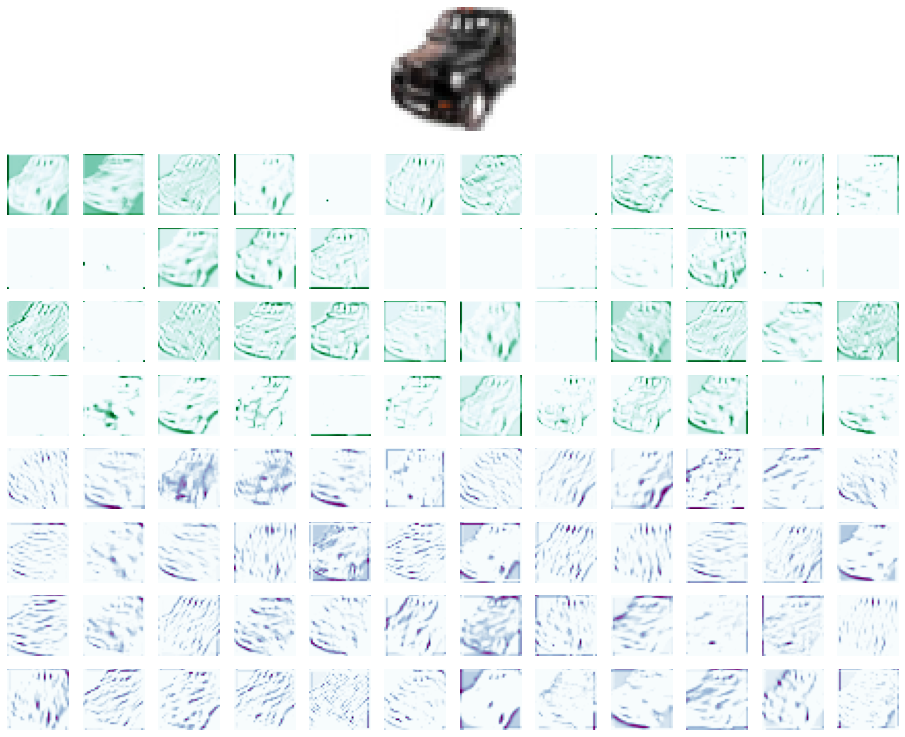

In [38]:
conv = [layer.output for layer in AugNetV2.layers if 'conv2d' in layer.name]
model = tf.keras.models.Model(inputs=AugNetV2.inputs, outputs=conv)

img = X_test[None, 18]
feature_maps = model.predict(img)

plt.rcParams["figure.figsize"] = (16, 16)

plt.subplot(6, 3, 2)
plt.imshow(img[0])
plt.axis('off')

for i in range(48):
  ax = plt.subplot(12, 12, i+25)
  plt.axis('off')
  plt.imshow(feature_maps[0][..., i][0], cmap='BuGn')

  ax = plt.subplot(12, 12, i+73)
  plt.axis('off')
  plt.imshow(feature_maps[1][..., i][0], cmap='BuPu')

clear_output()
plt.show()

## Results on the test set

In [39]:
AugNetV2.compile(optimizer=AugNetV2.optimizer,
                 loss=AugNetV2.loss,
                 metrics=metrics)

AugNetV2.evaluate(X_test, y_test)

282/282 [==============================] - 2s 5ms/step - loss: 0.4173 - accuracy: 0.8742 - f1: 0.8726 - auc: 0.9865


[0.4092209041118622,
 0.8767777681350708,
 0.8754771947860718,
 0.9863666892051697]

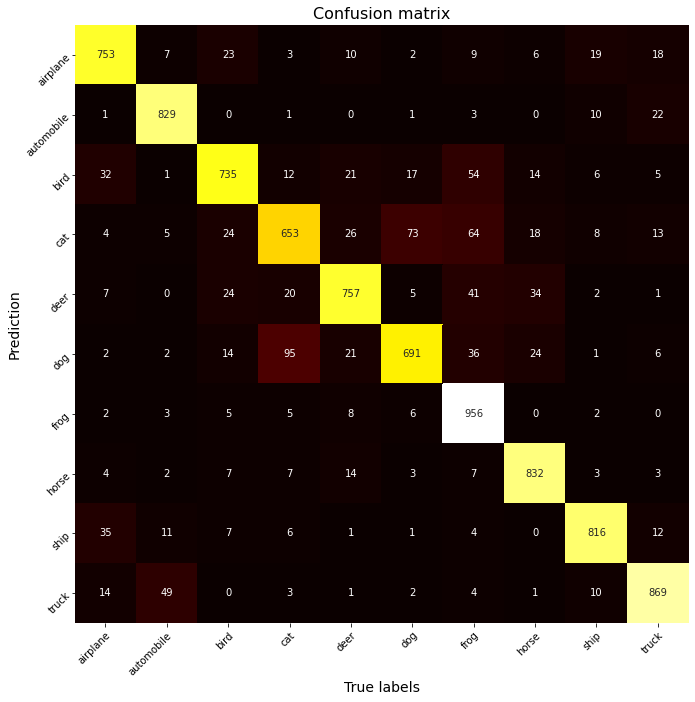

In [40]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

labels = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']

y_pred = AugNetV2.predict(X_test)

fig, ax = plt.subplots(figsize=(11, 11))

plt.title('Confusion matrix', fontsize=16);
sns.heatmap(
    confusion_matrix(y_test.argmax(axis=1), y_pred.argmax(axis=1)),
    annot=True, cbar=False,
    cmap='hot', fmt='.0f',
    xticklabels=labels, yticklabels=labels
)
plt.xlabel('True labels', fontsize=14)
plt.ylabel('Prediction', fontsize=14)
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor");
plt.setp(ax.get_yticklabels(), rotation=45, ha="right", rotation_mode="anchor");

Доля неправильної класифікації відносно невелика.

Найчастіше спостерігається проблема неправильної класифікації зображень тварин, особливо котів та собак, чиї зображення, ймовірно, в датасеті зустрічаються в схожій обстановці та в схожих позах

## Testing on the images from test set

In [41]:
labels = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']

def create_table(ax, y_true, y_pred):
    y_true = y_true.ravel()
    y_pred = y_pred.ravel()
    table = [[label, proba] for label, proba in zip(labels, y_pred)]
    colours = [['w', 'w'] for _ in labels]
    colours[y_true.argmax()][0] = 'g'
    colours[y_pred.argmax()][1] = 'y'
    table = ax.table(table, loc='center',
                   cellLoc='left', cellColours = colours)
    table.set_fontsize(12)
    ax.axis('off')

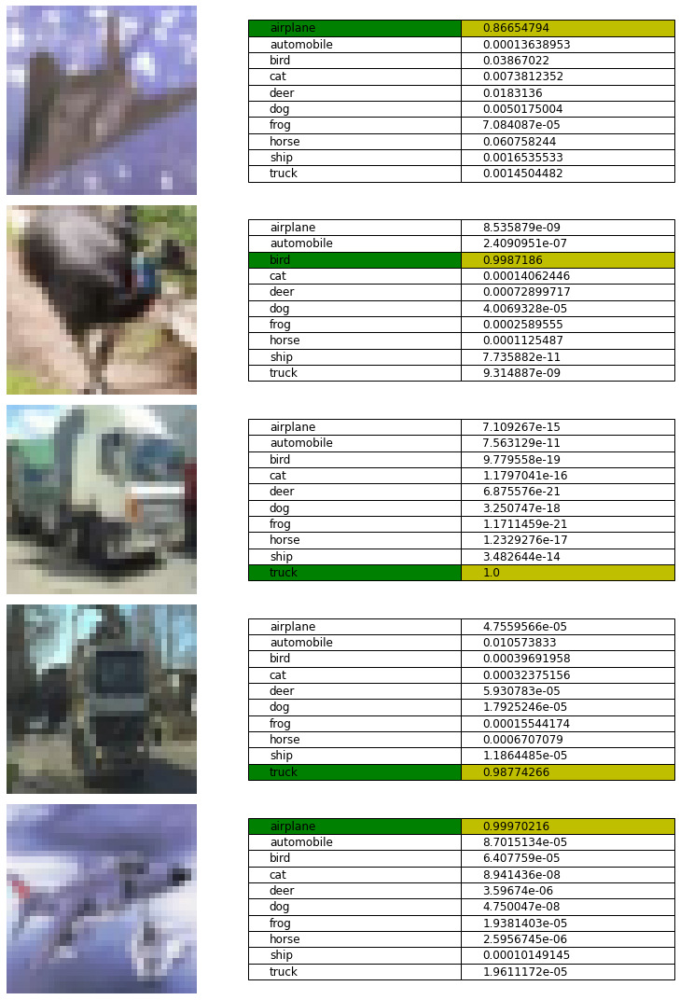

In [42]:
fig, ax = plt.subplots(5, 2, figsize=(12, 15))

indexes = np.random.randint(len(y_test), size=5)
for i, ind in enumerate(indexes):
    ax[i, 0].imshow(X_test[ind])
    ax[i, 0].axis('off')

    prediction = AugNetV2.predict(X_test[None, ind]).flatten()
    create_table(ax[i, 1], y_test[ind], prediction)
  
plt.tight_layout()

## Misclassification examples

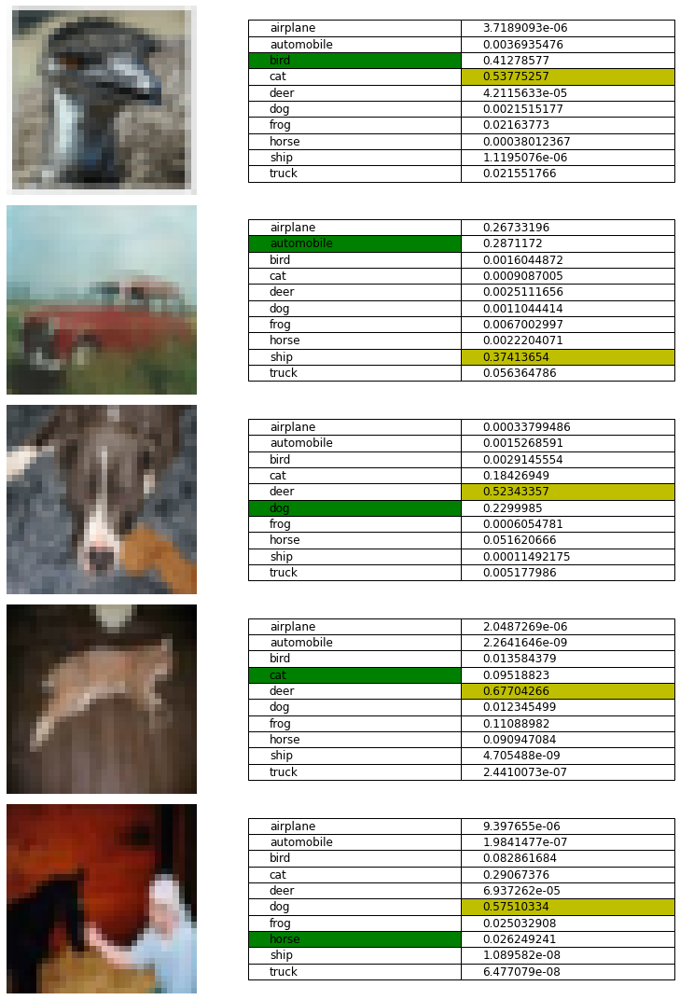

In [43]:
fig, ax = plt.subplots(5, 2, figsize=(12, 15))

indexes = np.random.choice(
    np.argwhere(y_test.argmax(axis=1) != y_pred.argmax(axis=1)).ravel(), size=5
    )
for i, ind in enumerate(indexes):
    ax[i, 0].imshow(X_test[ind])
    ax[i, 0].axis('off')

    prediction = y_pred[ind].flatten()
    create_table(ax[i, 1], y_test[ind], prediction)
  
plt.tight_layout()

## Testing on new images

In [44]:
from skimage.transform import resize
from skimage.io import imread

def load_predict_plot(url, true_label):
    original_image = imread(url)
    cropped_image = original_image
    shape = original_image.shape
    if shape[0] < shape[1]:
        margin = int((shape[1] - shape[0])/2)
        cropped_image = original_image[:, margin:-margin]
    if shape[0] > shape[1]:
        margin = int((shape[0] - shape[1])/2)
        cropped_image = original_image[margin:-margin]
    image = resize(cropped_image, (32, 32))
    encoded_label = np.array([[int(true_label==label) for label in labels]])

    prediction = AugNetV2.predict(image[None, ...])

    fig, ax = plt.subplots(1, 3, figsize=(13, 4))

    ax[0].imshow(original_image)
    ax[1].imshow(image)
    create_table(ax[2], encoded_label, prediction)

    ax[0].set_title('Original', fontsize=16)
    ax[1].set_title('Preprocessed', fontsize=16)
    ax[2].set_title('Prediction', fontsize=16)

    ax[0].axis('off'); ax[1].axis('off')
    plt.tight_layout()

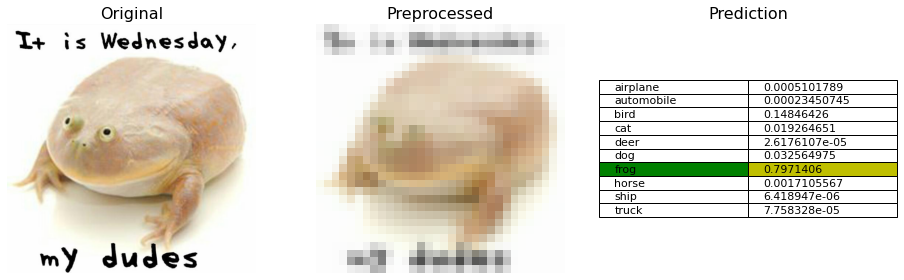

In [45]:
true_label = 'frog'
url = 'https://i.redd.it/14korqelmgx01.jpg'

load_predict_plot(url, true_label)

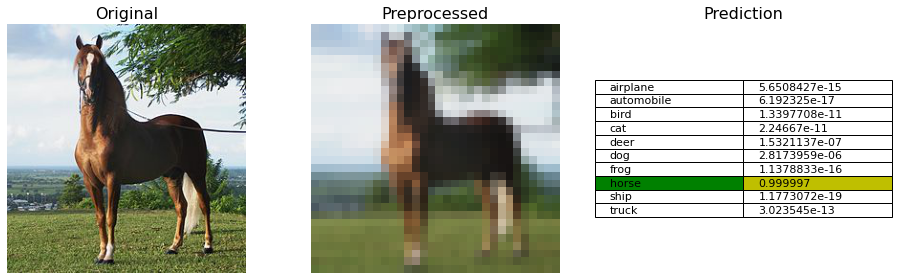

In [46]:
true_label = 'horse'
url = 'https://upload.wikimedia.org/wikipedia/commons/thumb/0/04/Puerto_rican-Paso-Fino-Horse-chestnut.jpg/250px-Puerto_rican-Paso-Fino-Horse-chestnut.jpg'

load_predict_plot(url, true_label)

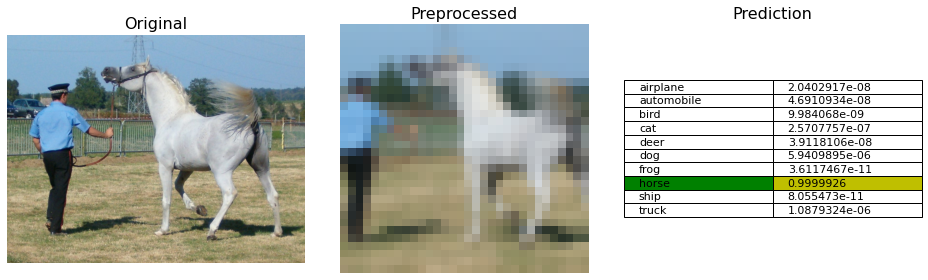

In [47]:
load_predict_plot('https://upload.wikimedia.org/wikipedia/commons/1/13/Arabe.jpg', 'horse')

## Summary

Можемо побачити, що більшість помилок модель робить з високою впевненістю в свої правоті, при чому на прикладах, що класифіковані правильно ймовірність відповідного класу дуже близька до одиниці. Таким чином можна сказати, що наша оцінка має малу дисперсію, проте дещо зсунута.

Всі спроби збільшити кількість параметрів по будь-якому з напрямків призводили до перенавчання та не змогли досягти порівняних результатів. З цього можна зробити припущення, що в даних умовах наша модель є однією з найкращих, і покращити результат можливо лише збільшивши навчальну вибірку використанням більш складної аугментації, іншого розділення на навчальну-тестову-валідаціну підвибірки або використанням попередньо навчених моделей (transfer learning).

# Learning curves with TensorBoard

In [48]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

# Inception V3

In [49]:
InceptionV3 = tf.keras.applications.InceptionV3(
    include_top=True,
    weights="imagenet",
    classifier_activation="softmax",
)

decode = tf.keras.applications.inception_v3.decode_predictions
scaling = tf.keras.applications.inception_v3.preprocess_input

image_preprocessor = Sequential(
  [
   layers.experimental.preprocessing.Resizing(299, 299, name="resizing"),
   layers.Activation(scaling, name='scaling')     
  ],
  name='ImagePreprocessor'
)

96116736/96112376 [==============================] - 0s 0us/step


In [50]:
from skimage.io import imread

def predict_with_inceptionv3(img=None, url=None, ax=None):
    if url is not None:
    img = imread(url)
    if img.dtype == np.dtype('float64'):
    img = (255*img).astype('int')
    if not ax:
    ax = plt
    ax.imshow(img)
    ax.axis('off')
    img = img[None, ...]
    img = image_preprocessor(img)
    prediction = InceptionV3.predict(img)

    return decode(prediction)

[[('n02110958', 'pug', 0.78494364),
  ('n02108422', 'bull_mastiff', 0.025393637),
  ('n02112706', 'Brabancon_griffon', 0.01768042),
  ('n02108915', 'French_bulldog', 0.011675298),
  ('n02099712', 'Labrador_retriever', 0.0040004854)]]

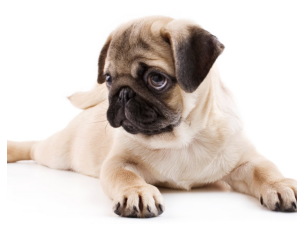

In [51]:
url = 'https://i.guim.co.uk/img/media/fe1e34da640c5c56ed16f76ce6f994fa9343d09d/0_174_3408_2046/master/3408.jpg?width=1200&height=900&quality=85&auto=format&fit=crop&s=0d3f33fb6aa6e0154b7713a00454c83d'

predict_with_inceptionv3(url=url)

[[('n02087046', 'toy_terrier', 0.45815098),
  ('n02219486', 'ant', 0.04452947),
  ('n02085620', 'Chihuahua', 0.019294249),
  ('n02113978', 'Mexican_hairless', 0.019126773),
  ('n02167151', 'ground_beetle', 0.01753321)]]

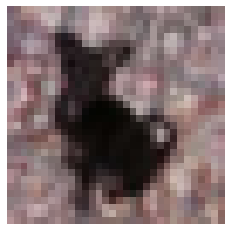

In [52]:
predict_with_inceptionv3(X_test[12])

[[('n02012849', 'crane', 0.18985263),
  ('n01518878', 'ostrich', 0.12595485),
  ('n01748264', 'Indian_cobra', 0.025599655),
  ('n02486261', 'patas', 0.01808155),
  ('n02493509', 'titi', 0.01463282)]]

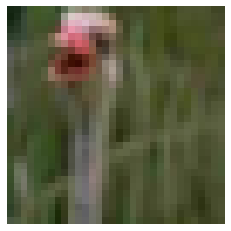

In [53]:
predict_with_inceptionv3(X_test[124])

# Transfer learning with Inception V3

## On flowers dataset
Спробуємо застосувати попереднє навчання для створення моделі-классифікатора квітів за зображенням.

### Data Loading

In [54]:
# https://www.kaggle.com/alxmamaev/flowers-recognition
classes = ['daisy', 'dandelion', 'rose', 'sunflower', 'tulip']

flowers_train = tf.keras.preprocessing.image_dataset_from_directory(
    'flowers', labels='inferred', label_mode='categorical',
    class_names=classes, color_mode='rgb', image_size=(299, 299),
    shuffle=True, seed=SEED, validation_split=0.2, subset="training"
)

flowers_test = tf.keras.preprocessing.image_dataset_from_directory(
    'flowers', labels='inferred', label_mode='categorical',
    class_names=classes, color_mode='rgb', image_size=(299, 299),
    shuffle=True, seed=SEED, validation_split=0.2, subset="validation"
)

Found 4323 files belonging to 5 classes.
Using 3459 files for training.
Found 4323 files belonging to 5 classes.
Using 864 files for validation.


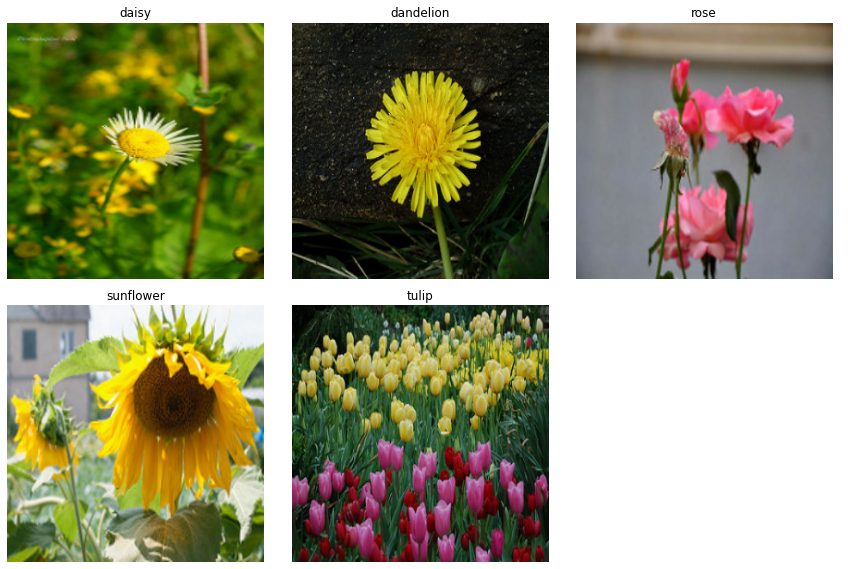

In [55]:
data = flowers_train.as_numpy_iterator()
arr = data.next()

fig, axs = plt.subplots(2, 3, figsize=(12, 8))

for i, ax in enumerate(axs.flatten()[:-1]):
    ind = np.random.choice(np.nonzero(arr[1][:, i])[0])
    ax.imshow(arr[0][ind].astype('int'))
    ax.set_title(flowers_train.class_names[i])
    ax.axis('off')

axs[1,2].axis('off')

plt.tight_layout()

### Model

In [56]:
inception_layers = InceptionV3.layers
inception_layers.pop()

for layer in inception_layers:
    layer.trainable = False

logit = Sequential([Dense(5, activation='softmax', kernel_regularizer='L2')])(inception_layers[-1].output)
model = tf.keras.Model(inputs=InceptionV3.inputs,
                       outputs=logit,
                       name='FlowersNet')

pipeline = Sequential([
    layers.Activation(scaling, name='scaling'),
    model
])

model.summary()

Model: "FlowersNet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
conv2d_188 (Conv2D)             (None, 149, 149, 32) 864         input_3[0][0]                    
__________________________________________________________________________________________________
batch_normalization_188 (BatchN (None, 149, 149, 32) 96          conv2d_188[0][0]                 
__________________________________________________________________________________________________
activation_188 (Activation)     (None, 149, 149, 32) 0           batch_normalization_188[0][0]    
_________________________________________________________________________________________

In [57]:
# pipeline.compile(optimizer='Adam', loss='categorical_crossentropy',
#                  metrics=[
#                    'accuracy',
#                    F1Score(5, average='macro', name='f1'),
#                    AUC(name='auc')
#                  ]
#                 )


# early_stopping = callbacks.EarlyStopping(monitor='val_loss', min_delta=0,
#                                          patience=3, verbose=1, mode='auto',
#                                          restore_best_weights=True)

history = pipeline.fit(flowers_train, epochs=30, initial_epoch=10,
                       validation_data=flowers_test.take(200),
                       callbacks=[
                          early_stopping,
                          TensorBoard(log_dir="logs/FlowersNet/")
                          ]
                       )

In [58]:
pipeline.layers[-1].save('models/FlowerNet_10ep')

INFO:tensorflow:Assets written to: models/FlowerNet_10ep/assets


In [59]:
pipeline = tf.keras.models.load_model('models/FlowerNet_10ep')

In [60]:
pipeline.compile(optimizer='Adam', loss='categorical_crossentropy',
                 metrics=[
                   'accuracy',
                   F1Score(5, average='macro', name='f1'),
                   AUC(name='auc')
                 ]
                )

### Testing

In [61]:
pipeline.evaluate(flowers_test)

27/27 [==============================] - 49s 415ms/step - loss: 0.4480 - accuracy: 0.8847 - f1: 0.8812 - auc: 0.9848


[0.4380509555339813,
 0.8900462985038757,
 0.8868862986564636,
 0.9858143329620361]

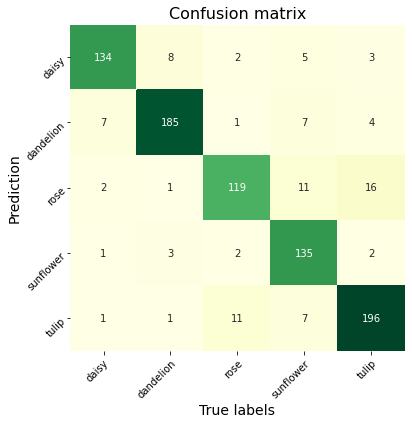

In [62]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

labels = flowers_test.class_names

tmp = [(x, y) for x, y in flowers_test.unbatch()]
y_flowers = np.concatenate([y for _, y in tmp], axis=0).reshape(-1, 5)
X_flowers = np.concatenate([x[None,...] for x, y in tmp], axis=0)
del tmp

y_pred = pipeline.predict(X_flowers)

fig, ax = plt.subplots(figsize=(6, 6))

plt.title('Confusion matrix', fontsize=16);
sns.heatmap(
    confusion_matrix(y_flowers.argmax(axis=1), y_pred.argmax(axis=1)),
    annot=True, cbar=False,
    cmap='YlGn', fmt='.0f',
    xticklabels=labels, yticklabels=labels
)
plt.xlabel('True labels', fontsize=14)
plt.ylabel('Prediction', fontsize=14)
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor");
plt.setp(ax.get_yticklabels(), rotation=45, ha="right", rotation_mode="anchor");

Така модель показує доволі непогані результати, враховуючи маленький обсяг навчальної вибірки, примітивне попереднє оброблення зображеннь (розтягування до потрібного розміру без врахування особливостей зображення), відсутність аугментації та, можливо, деякі зайві зображення в датасеті.

## On CIFAR10

In [63]:
inception_layers = InceptionV3.layers
inception_layers.pop()

for layer in inception_layers:
    layer.trainable = False

extractor = tf.keras.Model(inputs=InceptionV3.inputs, outputs=inception_layers[-1].output)
logit = Dense(10, activation='softmax', input_shape=(2048,))

c10_extractor = Sequential([
    layers.Activation(lambda x: tf.image.resize_with_pad(x, target_height=299, target_width=299)),
    image_preprocessor,
    extractor
])

In [64]:
X_train_2 = c10_extractor.predict(X_train*255)
X_val_2 = c10_extractor.predict(X_val*255)

In [65]:
logit = Sequential([logit])

logit.compile(
    optimizer='Adam', loss='categorical_crossentropy',
    metrics=[
      'accuracy',
      F1Score(10, average='macro', name='f1'),
      AUC(name='auc')
    ]
)

early_stopping = callbacks.EarlyStopping(monitor='val_loss', min_delta=0,
                                         patience=3, verbose=1, mode='auto',
                                         restore_best_weights=True)


history = logit.fit(X_train_2, y_train, epochs=50, initial_epoch=6,
                        validation_data=(X_val_2, y_val),
                        callbacks=[
                            # early_stopping,
                            TensorBoard(log_dir="logs/c10_logit/")
                            ]
                        )
logit.save('models/c10_logit')

Epoch 7/50
1313/1313 [==============================] - 7s 5ms/step - loss: 0.6694 - accuracy: 0.7892 - f1: 0.7885 - auc: 0.9698 - val_loss: 0.4041 - val_accuracy: 0.8648 - val_f1: 0.8651 - val_auc: 0.9890
Epoch 8/50
1313/1313 [==============================] - 5s 4ms/step - loss: 0.3660 - accuracy: 0.8749 - f1: 0.8749 - auc: 0.9907 - val_loss: 0.3819 - val_accuracy: 0.8720 - val_f1: 0.8726 - val_auc: 0.9895
Epoch 9/50
1313/1313 [==============================] - 5s 4ms/step - loss: 0.3241 - accuracy: 0.8883 - f1: 0.8882 - auc: 0.9926 - val_loss: 0.3928 - val_accuracy: 0.8680 - val_f1: 0.8696 - val_auc: 0.9886
Epoch 10/50
1313/1313 [==============================] - 5s 4ms/step - loss: 0.3046 - accuracy: 0.8956 - f1: 0.8954 - auc: 0.9932 - val_loss: 0.3681 - val_accuracy: 0.8752 - val_f1: 0.8750 - val_auc: 0.9904
Epoch 11/50
1313/1313 [==============================] - 5s 4ms/step - loss: 0.2943 - accuracy: 0.8985 - f1: 0.8983 - auc: 0.9936 - val_loss: 0.4048 - val_accuracy: 0.8691 - v

У випадку вихідного шару без додаткової регуляризації, результати наближаються до результатів найкращої моделі, що навчалась на цьому датасеті, при цьому в випадку використання Inception V3 модель значно схильніша до перенавчання, та тратить значно більше часу на обробку даних. Це пояснюється тим, що зображення CIFAR-10 мають дещо інші характеристики ніж ImageNet, а саме набагато нижчу роздільну здатність, що скоріш за все і призводить до не дуже якісного витягнення ознак з таких зображень.